# **Construction Site Safety Detection**

# **Overview**

Goal of this project is to detect the presence of people and their safety in the construction site and thereby improving work safety.

# ***Mounting the Google Drive***

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# **Table of contents**



*   **1. Data Description**
*   **2. Import modules**
*   **3. Configuration**
*   **4. Data Exploration**
*   **5. Train**
*   **6. Results**
*   **7. Test**
*   **8. Real-Time Construction Site Safety Detection**




# **Data Description**

- The dataset is a collection of images with the labels are in the following format: Glass, Gloves, Helmet, No-Helmet, Person, Safety-Boot, Safety-Vest

- **Quick Summary**
    - Number of classes: 7
    - Label Annotation: YOLO format (.txt)
    - PPE (Personal Protective Equipment) Class Map: {0: 'Glass', 1: 'Gloves', 2: 'Helmet', 3: 'No-Helmet', 4: 'Person', 5: 'Safety-Boot', 6: 'Safety-Vest'}

# **Import modules**

In [ ]:
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 530.3/530.3 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 198.8/198.8 kB 23.9 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import warnings
import matplotlib.pyplot as plt
from IPython.core.magic import register_line_cell_magic
import yaml
from PIL import Image
import os
import seaborn as sns
from ultralytics import YOLO
from matplotlib.patches import Rectangle
import glob
import cv2
import zipfile
from IPython.display import Image
from PIL import Image
from google.colab import files

# **Configuration**

In [ ]:
# Unzipping the Dataset

!unzip '/content/drive/MyDrive/Construction Site Safety Detection/Updated | Construction Site Safety Detection/css-data.zip'

Archive:  /content/drive/MyDrive/Construction Site Safety Detection/Updated | Construction Site Safety Detection/css-data.zip
   creating: css-data/
  inflating: css-data/README.dataset.txt  
  inflating: css-data/README.roboflow.txt  
   creating: css-data/test/
   creating: css-data/test/images/
  inflating: css-data/test/images/00000383_jpg.rf.f46fddfc5a063755f53e0fac49179741.jpg  
  inflating: css-data/test/images/20220621_132901_jpg.rf.e8750c1402671da76e5a5743ed28238b.jpg  
  inflating: css-data/test/images/20220621_132924_jpg.rf.f7716b6b293c170c61e3e9ea7327e736.jpg  
  inflating: css-data/test/images/20220721_161946_jpg.rf.2a199bf5693510cc70aa701340189fbe.jpg  
  inflating: css-data/test/images/20220721_162202_jpg.rf.c183ee50e351d9e23c32b8601bb7c98a.jpg  
  inflating: css-data/test/images/20220721_162553_jpg.rf.c72e3d65482045495309dcd1ae33d2cd.jpg  
  inflating: css-data/test/images/20220721_162848_jpg.rf.aacc300d8782fa89311bb68dc43dca79.jpg  
  inflating: css-data/test/images/94

In [ ]:
INPUT_DIR = '/content/css-data/'
WORK_DIR = '/content/working/'

# **Data Exploration**

## ***Create data YAML file***

In [ ]:
num_classes = 7
classes = ['Glass', 'Gloves', 'Helmet', 'No-Helmet', 'Person', 'Safety-Boot', 'Safety-Vest']

In [ ]:
dict_file = {'train': os.path.join(INPUT_DIR, 'train'),
             'val': os.path.join(INPUT_DIR, 'valid'),
             'test': os.path.join(INPUT_DIR, 'test'),
             'nc': num_classes,
             'names': classes
            }

with open(os.path.join(WORK_DIR, 'data.yaml'), 'w+') as file:
    yaml.dump(dict_file, file)

## ***Check class balance***

In [ ]:
class_idx = {str(i):classes[i] for i in range(num_classes)}

class_stat = {}
data_len = {}

for mode in ['train', 'valid', 'test']:

    class_count = {classes[i]:0 for i in range(num_classes)}

    path = os.path.join(INPUT_DIR, mode, 'labels')

    for file in os.listdir(path):

        with open(os.path.join(path, file)) as f:
            lines = f.readlines()

            for cls in set([line[0] for line in lines]):
                class_count[class_idx[cls]] += 1

    data_len[mode] = len(os.listdir(path))
    class_stat[mode] = class_count

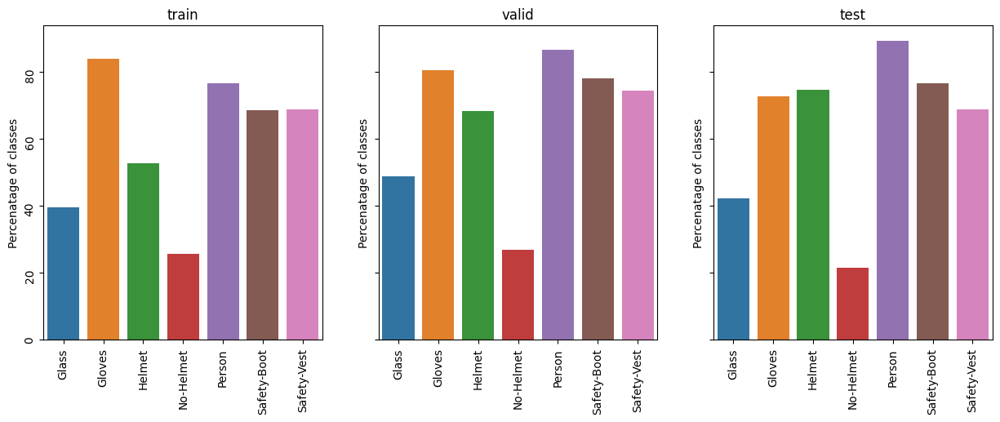

In [ ]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)

for i, mode in enumerate(['train', 'valid', 'test']):
    sns.barplot(pd.DataFrame({mode:class_stat[mode]}).T/data_len[mode]*100, ax=ax[i])
    ax[i].set_title(mode)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylabel('Percenatage of classes')
plt.show()

- There is imbalance in classes


- Overall class distribution between train, validation and test sets are similar

## ***Check image sizes***

In [ ]:
for mode in ['train', 'valid', 'test']:
    print(f'\nImage sizes in {mode} set:\n')
    img_size = 0
    for file in glob.glob(os.path.join(INPUT_DIR, mode, 'images', '*')):
        image = Image.open(file)
        if image.size != img_size:
            print(f'\t{image.size}')
            img_size = image.size


Image sizes in train set:

	(640, 640)

Image sizes in valid set:

	(640, 640)

Image sizes in test set:

	(640, 640)


- All images have size `640x640`

## ***Check dataset sizes***

In [ ]:
for mode in ['train', 'valid', 'test']:

    files =  glob.glob(os.path.join(INPUT_DIR, mode, 'images', '*'))

    print(f'{mode} set size: {len(files)}\n')

train set size: 958

valid set size: 82

test set size: 102



# **Train**

## ***Arguments for training***

- **task**: preform `detect`, `segment` or `classify`
- **imgsz**: define input image size
- **batch**: determine batch size
- **epochs**: define the number of training epochs.
- **data**: set the path to our yaml file
- **mode**: mode - `train`, `val` or `predict`
- **model**: model to use (could be pre-trained)
- **name**: result names

## ***Load model***

- Load `pre-trained` YOLO-nano model

In [ ]:
model = YOLO('yolov8n.pt')

100%|██████████| 6.23M/6.23M [00:00<00:00, 16.6MB/s]


## ***Train***

In [ ]:
model.train(data=os.path.join(WORK_DIR,'data.yaml'),
            task='detect',
            imgsz=640,
            epochs=50,
            batch=32,
            mode='train',
            name='yolov8n_v1_train')

Ultralytics YOLOv8.0.86 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/working/data.yaml, epochs=50, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8n_v1_train, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dyna

# **Results**

## ***Training Results***

### ***F1_Curve***

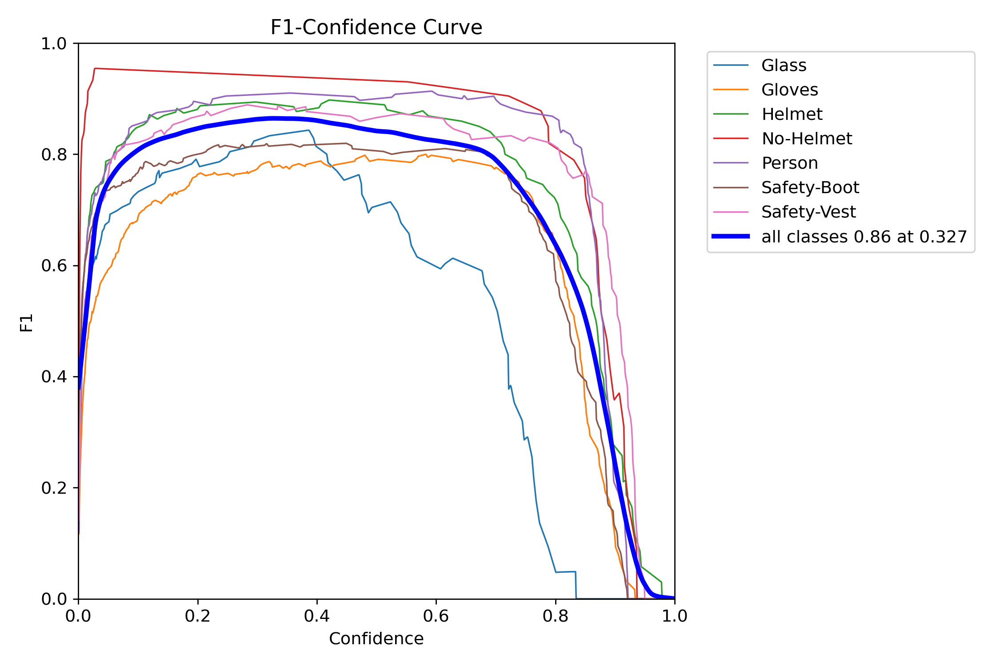

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/F1_curve.png')

### ***P_Curve***

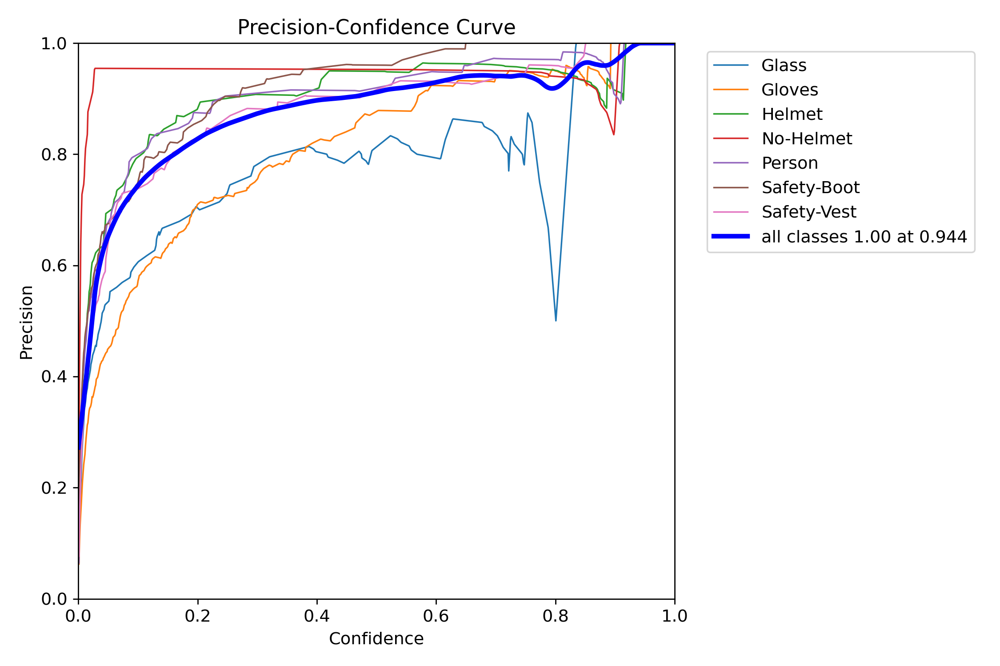

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/P_curve.png')

### ***R_Curve***

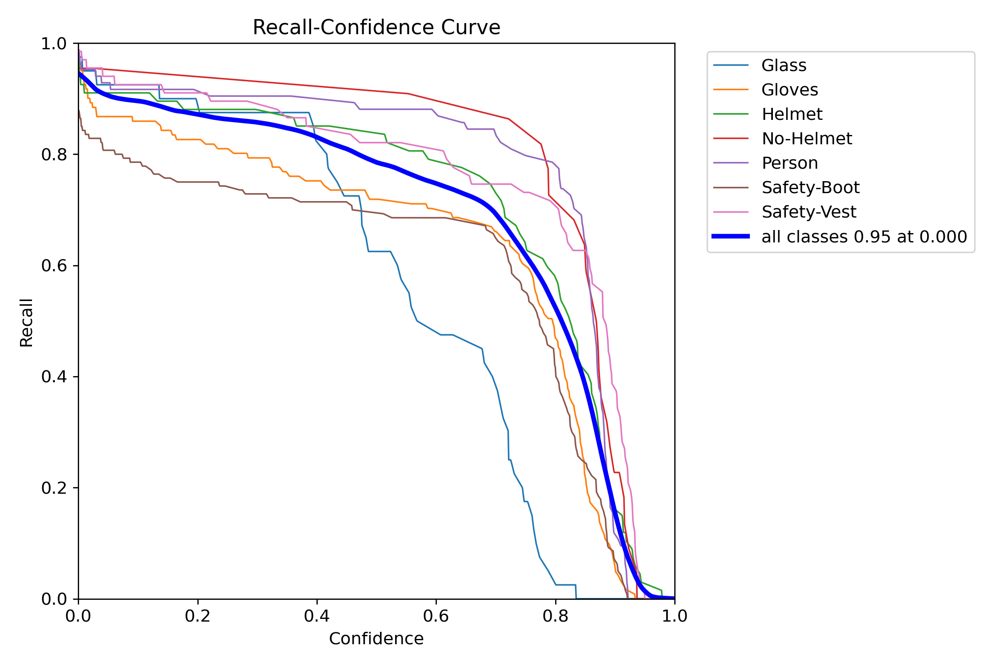

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/R_curve.png')

### ***PR_Curve***

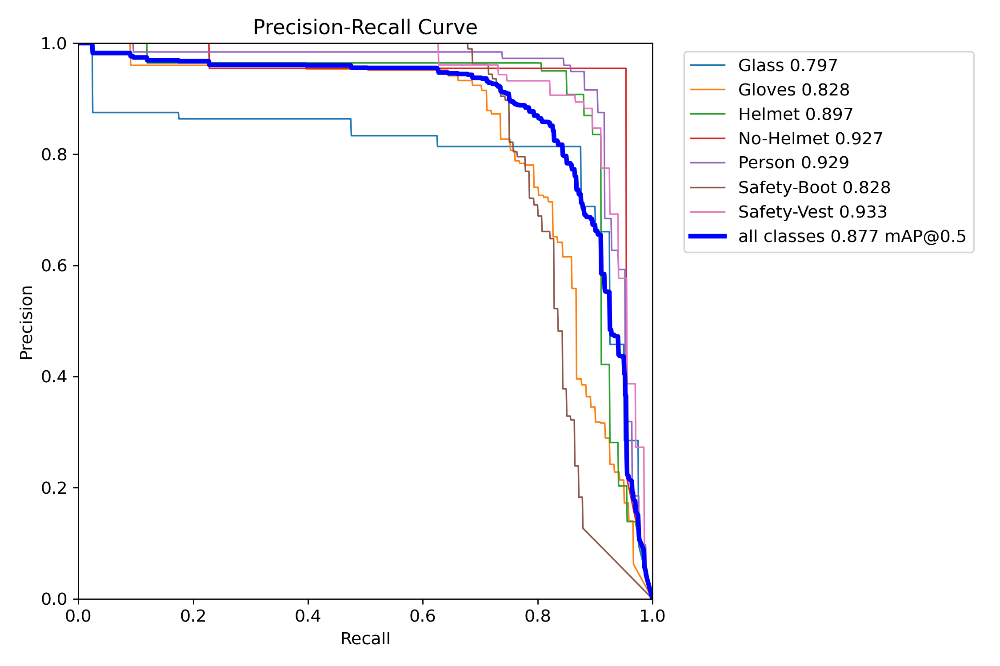

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/PR_curve.png')

### ***Confusion_Matrix***

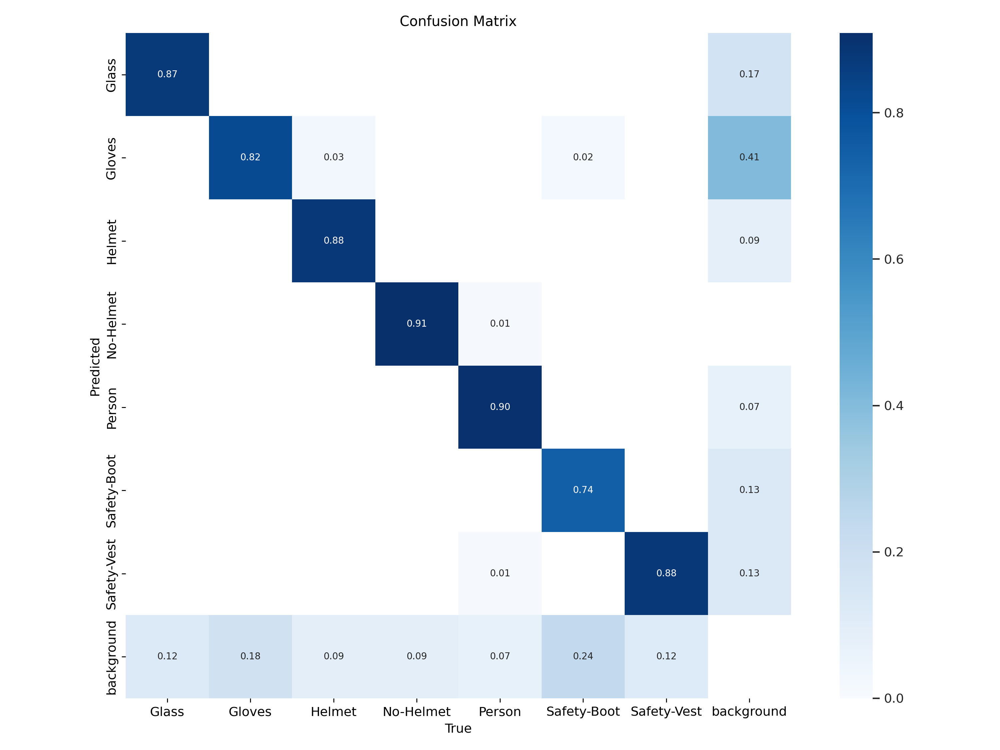

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/confusion_matrix.png')

### ***Model's Performance Evaluation Curve***

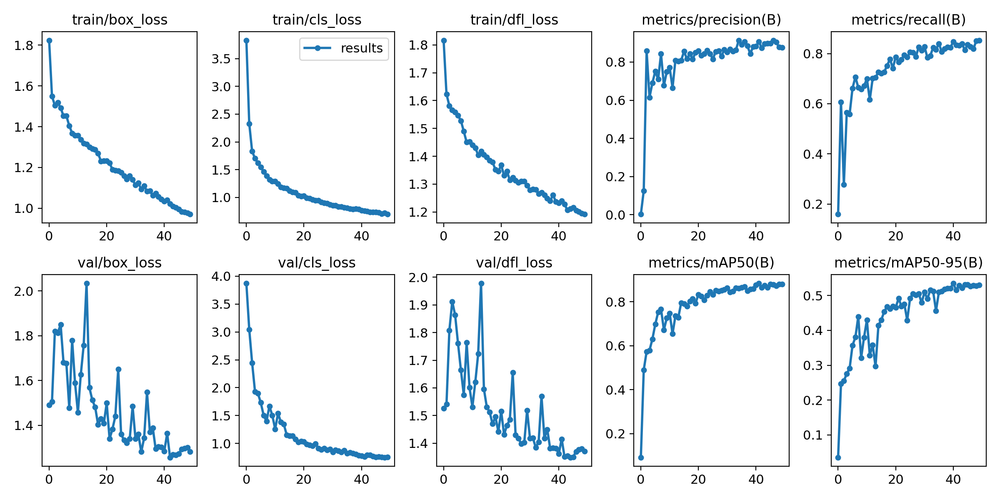

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/results.png')

### ***Predictions - Training***

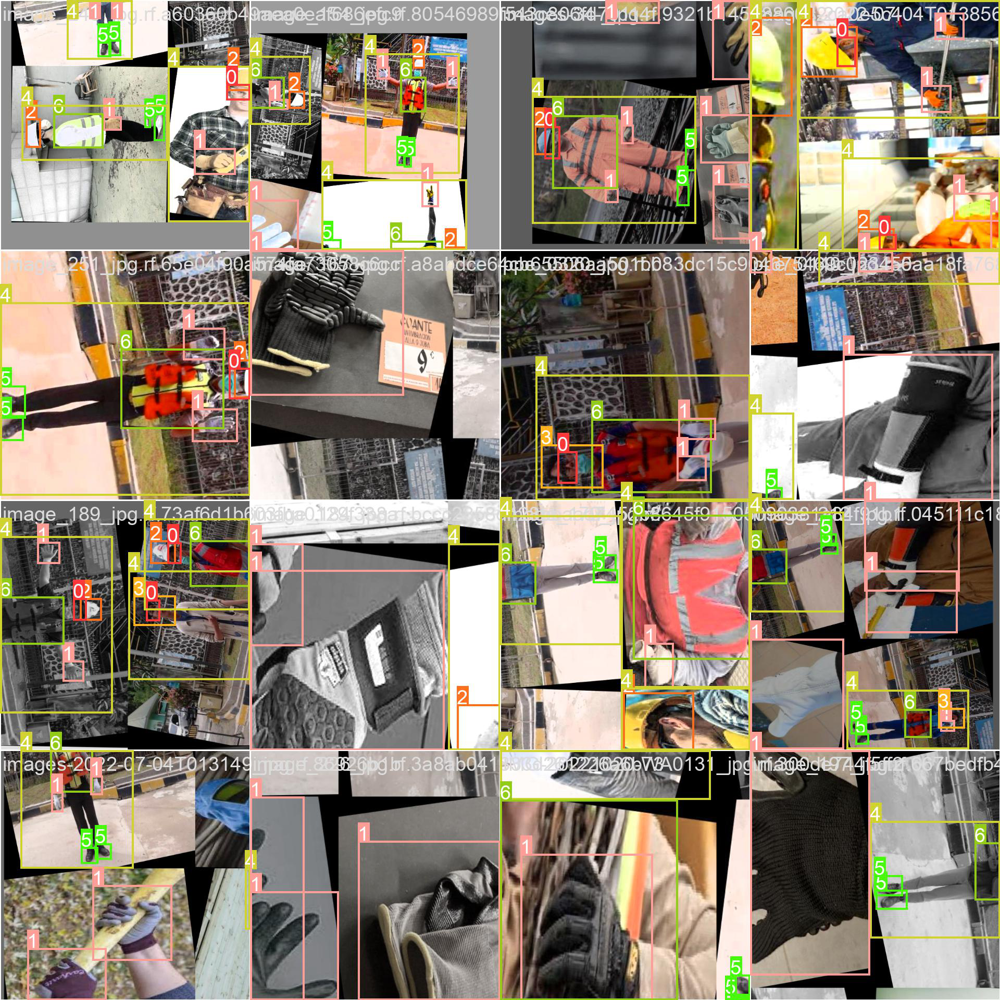

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/train_batch2.jpg')

## ***Validation Results***

### ***Predictions - Validation***

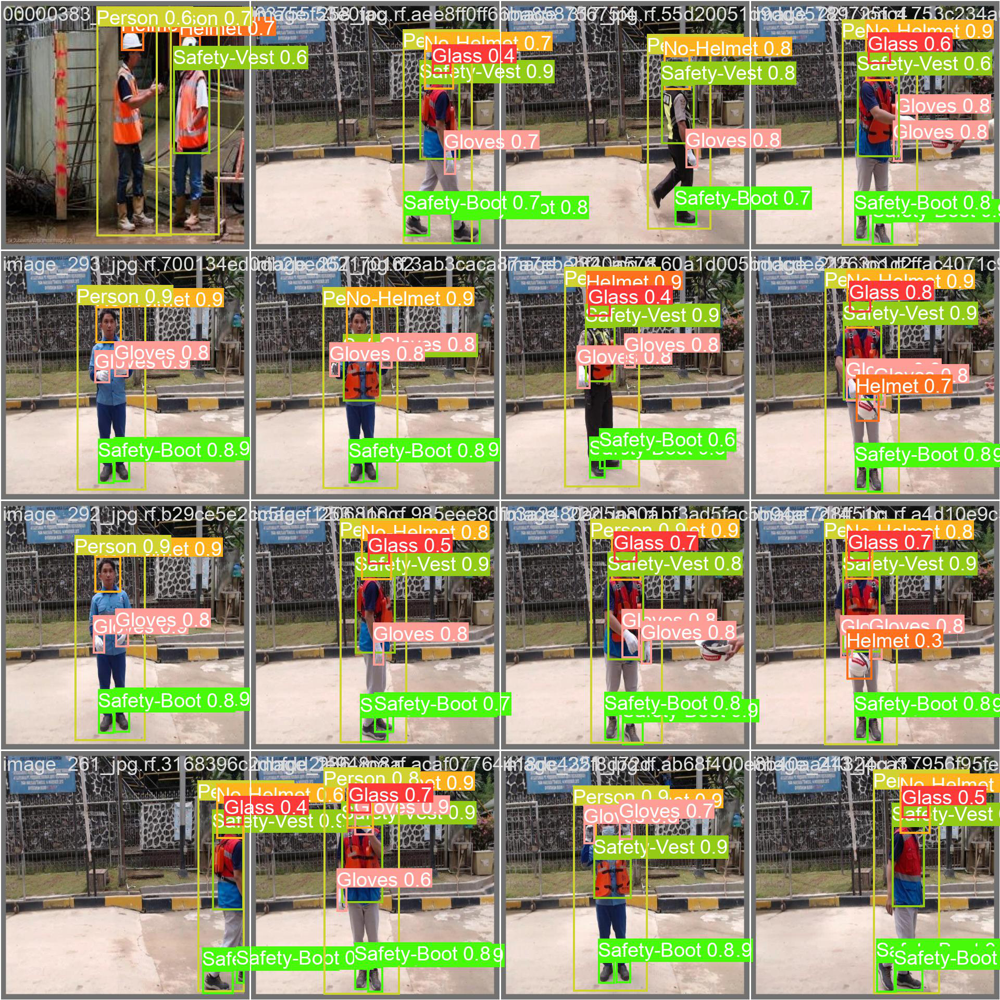

In [ ]:
Image.open('/content/runs/detect/yolov8n_v1_train/val_batch0_pred.jpg')

# **Test**

## ***Load the best model***

In [ ]:
model = YOLO('runs/detect/yolov8n_v1_train/weights/best.pt')

## ***Make predicitons on test set***

In [ ]:
results = model.predict(source=os.path.join(INPUT_DIR, 'test', 'images'), save=True)


image 1/102 /content/css-data/test/images/00000383_jpg.rf.f46fddfc5a063755f53e0fac49179741.jpg: 640x640 2 Helmets, 2 Persons, 1 Safety-Vest, 14.7ms
image 2/102 /content/css-data/test/images/20220621_132901_jpg.rf.e8750c1402671da76e5a5743ed28238b.jpg: 640x640 1 Helmet, 1 Person, 2 Safety-Boots, 1 Safety-Vest, 8.4ms
image 3/102 /content/css-data/test/images/20220621_132924_jpg.rf.f7716b6b293c170c61e3e9ea7327e736.jpg: 640x640 1 Helmet, 1 Person, 2 Safety-Boots, 1 Safety-Vest, 8.7ms
image 4/102 /content/css-data/test/images/20220721_161946_jpg.rf.2a199bf5693510cc70aa701340189fbe.jpg: 640x640 1 Gloves, 1 Person, 1 Safety-Boot, 7.6ms
image 5/102 /content/css-data/test/images/20220721_162202_jpg.rf.c183ee50e351d9e23c32b8601bb7c98a.jpg: 640x640 2 Glovess, 8.2ms
image 6/102 /content/css-data/test/images/20220721_162553_jpg.rf.c72e3d65482045495309dcd1ae33d2cd.jpg: 640x640 3 Glovess, 8.2ms
image 7/102 /content/css-data/test/images/20220721_162848_jpg.rf.aacc300d8782fa89311bb68dc43dca79.jpg: 640x

## ***Show prediction results***

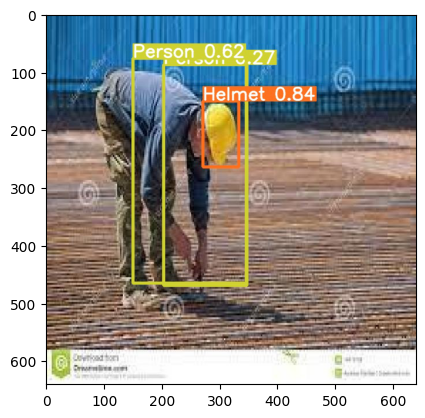

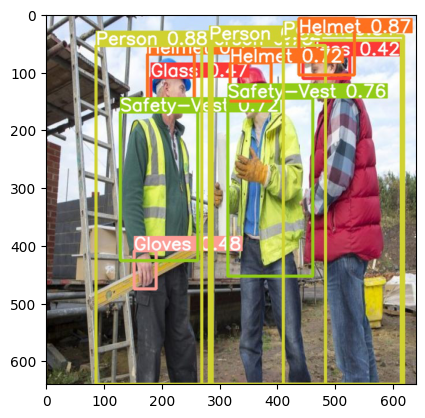

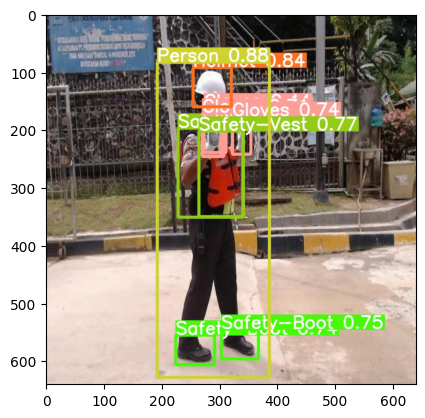

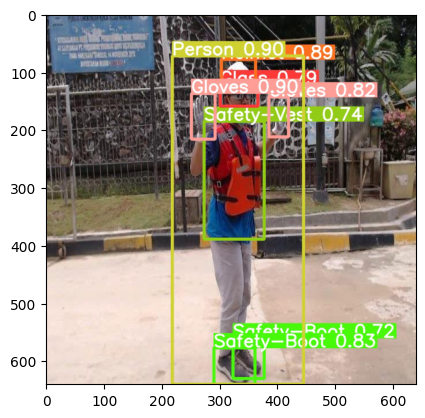

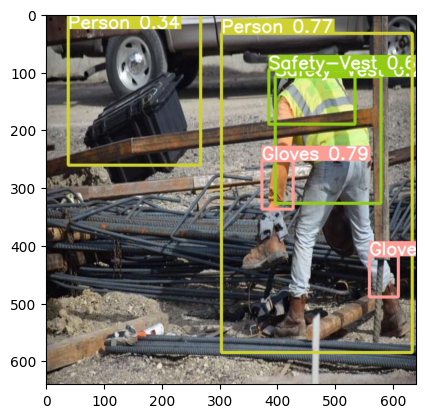

...

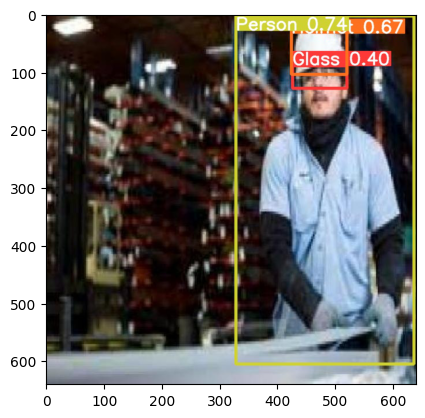

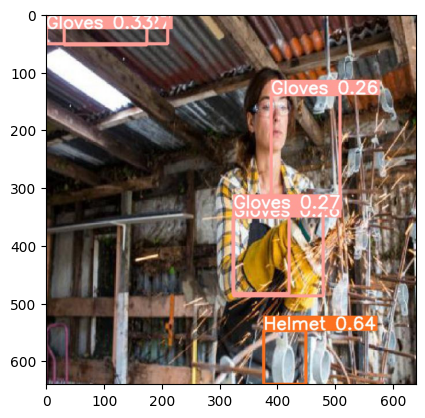

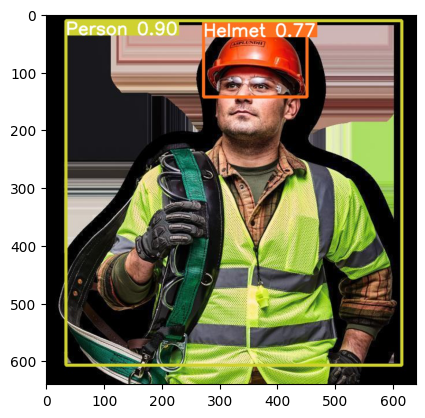

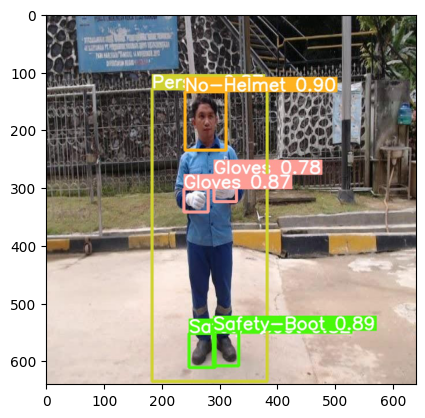

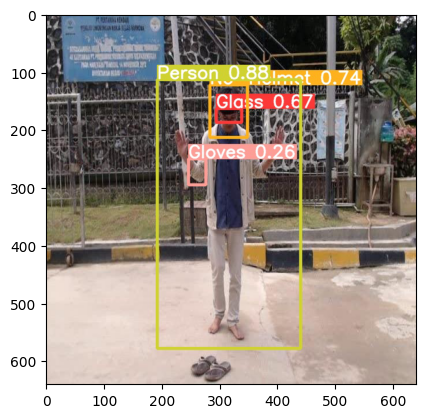

In [ ]:
%matplotlib inline

predicitions = glob.glob(os.path.join('/content/runs/detect/predict', '*'))

n = 25

for i in range(n):
    #idx = np.random.randint(0, len(predicitions))
    image = Image.open(predicitions[i])
    plt.imshow(image)
    plt.grid(False)
    plt.show()

# **Real-Time Construction Site Safety Detection**

## ***Installing Necessary Libraries***

In [ ]:
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 530.3/530.3 kB 27.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 198.8/198.8 kB 26.9 MB/s eta 0:00:00


## ***Importing Necessary Libraries***

In [ ]:
from ultralytics import YOLO
from IPython.display import Image
from PIL import Image
from google.colab import files

## ***Loading the Best Model***

In [ ]:
model = YOLO('/content/drive/MyDrive/Construction Site Safety Detection/Updated | Construction Site Safety Detection/best.pt')

## **>> Image Dataset**

## ***Loading the Image from the Local Disk***

In [ ]:
uploaded = files.upload()

Saving li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.jpg to li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.jpg


## ***Displaying the Uploaded Image***

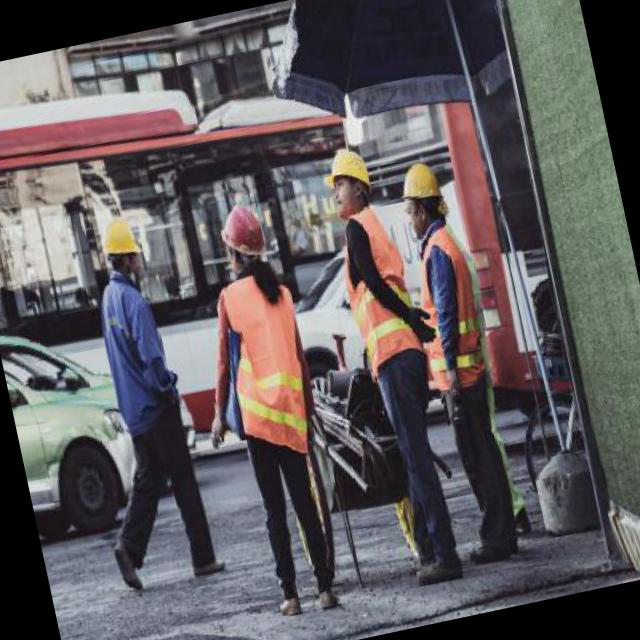

In [ ]:
Image.open('/content/li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.jpg')

In [ ]:
img = Image.open('/content/li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.jpg')

## ***Performing Prediction***

In [ ]:
results = model.predict(source=img,save=True)


0: 640x640 2 Glovess, 4 Helmets, 6 Persons, 6 Safety-Boots, 4 Safety-Vests, 135.2ms
Speed: 0.6ms preprocess, 135.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict


## ***Visualizing the Result***

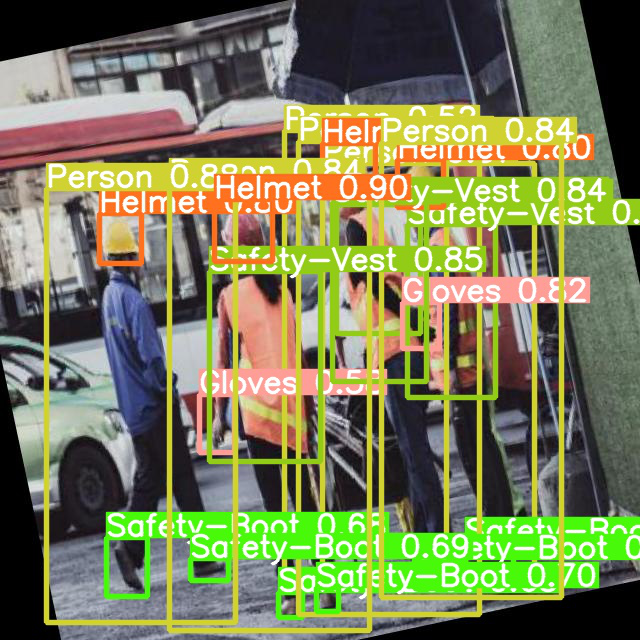

In [ ]:
Image.open('/content/runs/detect/predict/li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.jpg')

## ***Obtaining Inference***

In [ ]:
results = model.predict(source=img,save_txt=True)


0: 640x640 2 Glovess, 4 Helmets, 6 Persons, 6 Safety-Boots, 4 Safety-Vests, 147.8ms
Speed: 2.8ms preprocess, 147.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict
1 label saved to runs/detect/predict/labels


In [ ]:
file = open('/content/runs/detect/predict/labels/li-lin-rZcC9J5ZT6I-unsplash_jpg.rf.77e6368bd6381ff5a119b1a4a09af9a3.txt')
text = file.read()
file.close()

In [ ]:
text

'2 0.380833 0.360202 0.0907164 0.0961242\n4 0.220104 0.633652 0.295461 0.678228\n6 0.41347 0.573147 0.173186 0.29696\n4 0.420657 0.635877 0.313105 0.697555\n4 0.736101 0.577866 0.281346 0.710287\n6 0.593112 0.456715 0.14583 0.280108\n1 0.657841 0.508054 0.0585247 0.0719519\n2 0.18781 0.372758 0.0658347 0.0786239\n2 0.65665 0.286443 0.0717217 0.074832\n6 0.705661 0.485917 0.138673 0.269941\n2 0.545643 0.266728 0.0836582 0.0849411\n5 0.512095 0.937162 0.0350541 0.0369755\n5 0.327434 0.889849 0.0591893 0.0346312\n5 0.198035 0.885668 0.0641676 0.0930832\n5 0.687296 0.896767 0.0800933 0.0459394\n4 0.608446 0.590144 0.282683 0.739388\n5 0.453832 0.945986 0.0388548 0.0390503\n1 0.339158 0.662103 0.0538338 0.0908457\n5 0.764827 0.867727 0.0737202 0.0396324\n4 0.570753 0.559453 0.252675 0.71023\n4 0.66984 0.586161 0.331935 0.662753\n6 0.591206 0.420327 0.131847 0.201118\n'

In [ ]:
class_names = {0: 'Glass', 1: 'Gloves', 2: 'Helmet', 3: 'NO-Helmet', 4: 'Person', 5: 'Safety-Boot', 6: 'Safety-Vest'}

In [ ]:
lst = []

for i in text.split('\n')[:-1]:
    lst.append(class_names[int(i.split(' ')[0])])

In [ ]:
lst

['Helmet',
 'Person',
 'Safety-Vest',
 'Person',
 'Person',
 'Safety-Vest',
 'Gloves',
 'Helmet',
 'Helmet',
 'Safety-Vest',
 'Helmet',
 'Safety-Boot',
 'Safety-Boot',
 'Safety-Boot',
 'Safety-Boot',
 'Person',
 'Safety-Boot',
 'Gloves',
 'Safety-Boot',
 'Person',
 'Person',
 'Safety-Vest']

In [ ]:
new_lst = []
for i in set(lst):
    new_lst.append([i,lst.count(i)])

In [ ]:
df = pd.DataFrame(new_lst,columns=['Objects','Counts'])

In [ ]:
df

,Objects,Counts
0,Safety-Boot,6
1,Helmet,4
2,Gloves,2
3,Safety-Vest,4
4,Person,6


In [ ]:
df.to_csv('result.csv',index=False)

## ***Loading the result.csv File***

In [ ]:
df = pd.read_csv('result.csv')

In [ ]:
df

,Objects,Counts
0,Safety-Boot,6
1,Helmet,4
2,Gloves,2
3,Safety-Vest,4
4,Person,6


In [ ]:
data = []
for i in df.values:
  if(i[0]=='Safety-Boot' or i[0]=='Gloves'):
    data.append([i[0],int(i[1]/2)])
  else:
    data.append([i[0],int(i[1])])

In [ ]:
df = pd.DataFrame(data,columns=['Objects','Counts'])

In [ ]:
df

,Objects,Counts
0,Safety-Boot,3
1,Helmet,4
2,Gloves,1
3,Safety-Vest,4
4,Person,6


In [ ]:
print('Persons with Helmet' ,'       :', np.round(((df[df['Objects']=='Helmet']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100,2),'%')
print('Persons without Helmet' ,'    :', np.round((100 - ((df[df['Objects']=='Helmet']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100),2),'%')

Persons with Helmet        : 66.67 %
Persons without Helmet     : 33.33 %


In [ ]:
print('Persons with Safety-Vest' ,'       :', np.round(((df[df['Objects']=='Safety-Vest']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100,2),'%')
print('Persons without Safety-Vest' ,'    :', np.round((100 - ((df[df['Objects']=='Safety-Vest']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100),2),'%')

Persons with Safety-Vest        : 66.67 %
Persons without Safety-Vest     : 33.33 %


In [ ]:
print('Persons with Gloves' ,'       :', np.round(((df[df['Objects']=='Gloves']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100,2),'%')
print('Persons without Gloves' ,'    :', np.round((100 - ((df[df['Objects']=='Gloves']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100),2),'%')

Persons with Gloves        : 16.67 %
Persons without Gloves     : 83.33 %


In [ ]:
print('Persons with  Safety-Boot' ,'       :', np.round(((df[df['Objects']=='Safety-Boot']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100,2),'%')
print('Persons without  Safety-Boot' ,'    :', np.round((100 - ((df[df['Objects']=='Safety-Boot']['Counts'].values[0])/df[df['Objects']=='Person']['Counts'].values[0])*100),2),'%')

Persons with  Safety-Boot        : 50.0 %
Persons without  Safety-Boot     : 50.0 %


## **>> Video Dataset**

## ***Loading the Video***

In [ ]:
import zipfile

In [ ]:
!unzip '/content/drive/MyDrive/Construction Site Safety Detection/Updated | Construction Site Safety Detection/realtime_test_data.zip'

Archive:  /content/drive/MyDrive/Construction Site Safety Detection/Updated | Construction Site Safety Detection/realtime_test_data.zip
   creating: content/source_files/
   creating: content/source_files/source_files/
  inflating: content/source_files/source_files/construction-safety.jpg  
  inflating: content/source_files/source_files/schupan_japan1web.jpg  
  inflating: content/source_files/source_files/images.jfif  
  inflating: content/source_files/source_files/portrait-of-woman-with-mask-and-man-with-safety-glasses-on-a-construction-HX01FH.jpg  
  inflating: content/source_files/source_files/two-young-construction-workers-wearing-555864.jpg  
  inflating: content/source_files/source_files/JapanPPE.mp4  
  inflating: content/source_files/source_files/indianworkers.mp4  
  inflating: content/source_files/source_files/hardhat.mp4  
  inflating: content/source_files/source_files/download.jfif  


### ***Video Used : content/source_files/source_files/hardhat.mp4***

## ***Performing Prediction and Obtaining Inference***

In [ ]:
results = model.predict(source='/content/content/source_files/source_files/hardhat.mp4',save=True)



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/1826) /content/content/source_files/source_files/hardhat.mp4: 384x640 (no detections), 122.4ms
video 1/1 (2/1826) /content/content/source_files/source_files/hardhat.mp4: 384x640 (no detections), 143.6ms
video 1/1 (3/1826) /content/content/source_files/source_files/hardhat.mp4: 384x640 (no detections), 153.4ms
video 1/1 (4/1826) /content/content/source_files/source_files/hardhat.mp4: 384x640 (no detections), 125.9ms
video 1/1 (5/1826) /content